# GROUP THREE: Buffers, or more interesting/complicated analysis

In [1]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

%matplotlib inline


## 1. Do states with coal power plants have dirtier air?

In [2]:
USshape = gpd.read_file("/14-homework-powerplants/cb_2016_us_state_500k/cb_2016_us_state_500k.shp")
USshape.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999..."


In [3]:
USpowerplant = pd.read_csv("/14-homework-powerplants/powerplants.csv")
USpowerplant['geometry'] = USpowerplant.apply(
    lambda row: Point(row.Longitude, row.Latitude), axis=1)
USpowerplant = gpd.GeoDataFrame(USpowerplant)
USpowerplant.crs = {'proj':'merc'}
USpowerplant.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
0,2,Bankhead Dam,Alabama Power Co,195,Electric Utility,Northport,Tuscaloosa,35476,19001 Lock 17 Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 56 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,33.458665,-87.356823,POINT (-87.35682299999999 33.458665)


In [4]:
USair = pd.read_csv("/14-homework-powerplants/pm25_annual_fixed.csv")
USair['geometry'] = USair.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)
USair = gpd.GeoDataFrame(USair)
USair.crs = {'proj':'merc'}
USair.head(1)


,State Code,County Code,Site Num,Parameter Code,POC,Latitude,Longitude,Datum,Parameter Name,Sample Duration,...,50th Percentile,10th Percentile,Local Site Name,Address,State Name,County Name,City Name,CBSA Name,Date of Last Change,geometry
0,1,3,10,88101,1,30.497478,-87.880258,NAD83,PM2.5 - Local Conditions,24 HOUR,...,5.7,3.8,"FAIRHOPE, Alabama","FAIRHOPE HIGH SCHOOL, 1 PIRATE DRIVE, FAIRHOPE...",Alabama,Baldwin,Fairhope,"Daphne-Fairhope-Foley, AL",2017-05-18,POINT (-87.880258 30.497478)


In [5]:
USair.shape


(441, 56)

In [6]:
# USair.dtypes


In [7]:
USpowerplant_coal = USpowerplant[~USpowerplant['Coal_MW'].isnull()]
USpowerplant_coal = USpowerplant_coal[ USpowerplant_coal['Coal_MW'] != 0.0]
USpowerplant_coal.shape


(408, 29)

In [8]:
# USpowerplant_coal = USpowerplant_coal.to_crs({'proj':'merc'})
# USshape_coal = USair.copy()
USair = USair.to_crs({'proj':'merc'})


In [9]:
print(USpowerplant_coal.crs)
# print(USshape_coal.crs)
print(USair.crs)


{'proj': 'merc'}
{'proj': 'merc'}


In [10]:
# 1 mile = 1609.34 meters

# 1        degree of Longitude = 55.2428 miles


### 1) Air quality of 10 mile circle about coal power plants

In [11]:
# 0.1810102 degree of Longitude = 10 miles


In [12]:
buffered_USpowerplant_coal = USpowerplant_coal.buffer(0.1810102)
buffered_USpowerplant_coal.head(1)


1    POLYGON ((-87.8292898 31.0069, -87.83016141358...
dtype: object

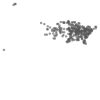

In [13]:
buffered_USpowerplant_coal.unary_union


In [14]:
USair_coal_near = USair[USair.within(buffered_USpowerplant_coal.unary_union)]
USair_coal_far = USair[~USair.intersects(buffered_USpowerplant_coal.unary_union)]


In [15]:
print(USair_coal_near.shape)
print(USair_coal_far.shape)

(117, 56)
(324, 56)


In [16]:
print(USair_coal_near['Arithmetic Mean'].mean() )
print(USair_coal_far['Arithmetic Mean'].mean() )


8.21962305983
7.8369835679


Air quality within 10 mile circle about coal power plants is dirtier than the air 10 mile away.


### 2) Air quality of 50 mile circle about coal power plants

In [17]:
# 0.9050953 degree of Longitude = 50 miles


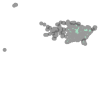

In [18]:
buffered_USpowerplant_coal = USpowerplant_coal.buffer(0.9050953)
buffered_USpowerplant_coal.unary_union


In [19]:
USair_coal_near = USair[USair.intersects(buffered_USpowerplant_coal.unary_union)]
USair_coal_far = USair[~USair.intersects(buffered_USpowerplant_coal.unary_union)]


In [20]:
print(USair_coal_near.shape)
print(USair_coal_far.shape)


(348, 56)
(93, 56)


In [21]:
print(USair_coal_near['Arithmetic Mean'].mean() )
print(USair_coal_far['Arithmetic Mean'].mean() )


7.97980372126
7.78394493548


Air quality within 50 mile circle about coal power plants is similar but still dirtier than the air 50 mile away.


### 3) Air quality of 100 mile circle about coal power plants

In [22]:
# 1.810102 degree of Longitude = 100 miles

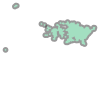

In [23]:
buffered_USpowerplant_coal = USpowerplant_coal.buffer(1.810102)
buffered_USpowerplant_coal.unary_union


In [24]:
USair_coal_near = USair[USair.within(buffered_USpowerplant_coal.unary_union)]
USair_coal_far = USair[~USair.within(buffered_USpowerplant_coal.unary_union)]


In [25]:
print(USair_coal_near.shape)
print(USair_coal_far.shape)


(405, 56)
(36, 56)


In [26]:
print(USair_coal_near['Arithmetic Mean'].mean() )
print(USair_coal_far['Arithmetic Mean'].mean() )


7.97088065926
7.57421963889


Air quality within 100 mile circle about coal power plants is similar but still dirtier than the air 50 mile away.


## 2. Which power plants are within 75 miles of New York City?

In [27]:
cities = pd.read_json("/14-homework-powerplants/cities.json")
cities.head()


,city,growth_from_2000_to_2013,latitude,longitude,population,rank,state
0,New York,4.8%,40.712784,-74.005941,8405837,1,New York
1,Los Angeles,4.8%,34.052234,-118.243685,3884307,2,California
2,Chicago,-6.1%,41.878114,-87.629798,2718782,3,Illinois
3,Houston,11.0%,29.760427,-95.369803,2195914,4,Texas
4,Philadelphia,2.6%,39.952584,-75.165222,1553165,5,Pennsylvania


In [28]:
cities['geometry'] = cities.apply(lambda row: Point(row.longitude, row.latitude), axis=1)
cities = gpd.GeoDataFrame(cities)
cities.crs = {'proj': 'merc'}
cities.head()


,city,growth_from_2000_to_2013,latitude,longitude,population,rank,state,geometry
0,New York,4.8%,40.712784,-74.005941,8405837,1,New York,POINT (-74.0059413 40.7127837)
1,Los Angeles,4.8%,34.052234,-118.243685,3884307,2,California,POINT (-118.2436849 34.0522342)
2,Chicago,-6.1%,41.878114,-87.629798,2718782,3,Illinois,POINT (-87.6297982 41.8781136)
3,Houston,11.0%,29.760427,-95.369803,2195914,4,Texas,POINT (-95.3698028 29.7604267)
4,Philadelphia,2.6%,39.952584,-75.165222,1553165,5,Pennsylvania,POINT (-75.1652215 39.9525839)


In [29]:
city_NY = cities[cities['city']=='New York']
city_NY


,city,growth_from_2000_to_2013,latitude,longitude,population,rank,state,geometry
0,New York,4.8%,40.712784,-74.005941,8405837,1,New York,POINT (-74.0059413 40.7127837)


In [30]:
USpowerplant.crs = {'proj': 'merc'}


In [31]:
print(USpowerplant.crs)
print(city_NY.crs)


{'proj': 'merc'}
{'proj': 'merc'}


In [32]:
# 1        degree  of Longitude = 55.2428 miles
# 1.357643 degrees of Longitude = 75 miles
buffered_city_NY = city_NY.buffer(1.357643)
buffered_city_NY.head(1)


0    POLYGON ((-72.64829830000001 40.7127837, -72.6...
dtype: object

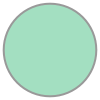

In [33]:
buffered_city_NY.unary_union


In [34]:
USpowerplant_near_NY = USpowerplant[USpowerplant.within(buffered_city_NY.unary_union)]
USpowerplant_near_NY


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
49,88,Ashokan,New York Power Authority,15296,Electric Utility,Kingston,Ulster,12401,Route 28A,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 4.6 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.949000,-74.206300,POINT (-74.2063 41.949)
341,539,Rocky River (CT),FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,200 Kent Road,pumped storage,...,0.0,NaN,NaN,Pumped Storage = 29.4 MW,Hydroelectric Pumped Storage,"EIA-860, EIA-860M and EIA-923",201607,41.582600,-73.434900,POINT (-73.4349 41.5826)
342,540,Branford,Connecticut Jet Power LLC,22379,IPP Non-CHP,Branford,New Haven,6450,Route 1,petroleum,...,0.0,NaN,NaN,Petroleum = 17.4 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.292500,-72.794200,POINT (-72.7942 41.2925)
343,541,Bulls Bridge,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,781 Kent Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 8.4 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.659046,-73.491984,POINT (-73.491984 41.659046)
344,542,Cos Cob,Connecticut Jet Power LLC,22379,IPP Non-CHP,Greenwich,Fairfield,6430,Sound Shore Drive,petroleum,...,0.0,NaN,NaN,Petroleum = 95.6 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.028900,-73.598900,POINT (-73.5989 41.0289)
345,544,Devon Station,Devon Power LLC,22350,IPP Non-CHP,Milford,New Haven,6460,734 Naugatuck Avenue,petroleum,...,0.0,NaN,NaN,Petroleum = 132.5 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.209797,-73.108976,POINT (-73.108976 41.20979699999999)
350,552,Shepaug,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,Southbury,New Haven,6488,2225 River Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 41.5 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.448420,-73.295321,POINT (-73.295321 41.44842)
351,553,Stevenson,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,Monroe,Fairfield,6468,1 Roosevelt Drive,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 28.9 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.383300,-73.171400,POINT (-73.17140000000001 41.3833)
362,568,Bridgeport Station,PSEG Power Connecticut LLC,15452,IPP Non-CHP,Bridgeport,Fairfield,6604,1 Atlantic Street,coal,...,0.0,NaN,NaN,"Coal = 383.4 MW, Petroleum = 16.9 MW",Conventional Steam Coal; Petroleum Liquids;,"EIA-860, EIA-860M and EIA-923",201607,41.170600,-73.184400,POINT (-73.1844 41.1706)
363,579,Central Hudson High Falls,Central Hudson Gas & Elec Corp,3249,Electric Utility,High Falls,ULSTER,12440,Route 213,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 3.2 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.828814,-74.131877,POINT (-74.131877 41.828814)


## 3. Map all of the power plants in New York, New Jersey, Pennsylvania and Connecticut. Have a nice bottom layer of those 4 states.

In [35]:
USpowerplant = pd.read_csv("/14-homework-powerplants/powerplants.csv")
USpowerplant['geometry'] = USpowerplant.apply(
    lambda row: Point(row.Longitude, row.Latitude), axis=1)
USpowerplant = gpd.GeoDataFrame(USpowerplant)
USpowerplant.crs = {'init':'epsg:4326'}
USpowerplant.head()

,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
0,2,Bankhead Dam,Alabama Power Co,195,Electric Utility,Northport,Tuscaloosa,35476,19001 Lock 17 Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 56 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,33.458665,-87.356823,POINT (-87.35682299999999 33.458665)
1,3,Barry,Alabama Power Co,195,Electric Utility,Bucks,Mobile,36512,North Highway 43,coal,...,0.0,NaN,NaN,"Coal = 1088.5 MW, Natural Gas = 1072 MW",Conventional Steam Coal; Natural Gas Fired Com...,"EIA-860, EIA-860M and EIA-923",201607,31.006900,-88.010300,POINT (-88.0103 31.0069)
2,4,Walter Bouldin Dam,Alabama Power Co,195,Electric Utility,Wetumpka,Elmore,36092,750 Bouldin Dam Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 225.9 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,32.583889,-86.283056,POINT (-86.283056 32.583889)
3,7,Gadsden,Alabama Power Co,195,Electric Utility,Gadsden,Etowah,35903,1000 Goodyear Ave,natural gas,...,0.0,NaN,NaN,Natural Gas = 130 MW,Natural Gas Steam Turbine,"EIA-860, EIA-860M and EIA-923",201607,34.012800,-85.970800,POINT (-85.9708 34.0128)
4,8,Gorgas,Alabama Power Co,195,Electric Utility,Parrish,Walker,35580,460 Gorgas Road,coal,...,0.0,NaN,NaN,Coal = 1034 MW,Conventional Steam Coal,"EIA-860, EIA-860M and EIA-923",201607,33.644344,-87.196486,POINT (-87.19648599999999 33.644344)


In [36]:
USshape = gpd.read_file("/14-homework-powerplants/cb_2016_us_state_500k/cb_2016_us_state_500k.shp")
USshape

,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999..."
1,0400000US02,1477946266785,245390495931,02,00,Alaska,02,01785533,AK,"(POLYGON ((-134.737262 58.261354, -134.73441 5..."
2,0400000US04,294198560125,1027346486,04,00,Arizona,04,01779777,AZ,"POLYGON ((-114.816294 32.508038, -114.814321 3..."
3,0400000US05,134771517596,2960191698,05,00,Arkansas,05,00068085,AR,"POLYGON ((-94.6178329666013 36.4994141203285, ..."
4,0400000US06,403501101370,20466718403,06,00,California,06,01779778,CA,"(POLYGON ((-118.604415 33.478552, -118.598783 ..."
5,0400000US08,268429343790,1175112870,08,00,Colorado,08,01779779,CO,"POLYGON ((-109.060253 38.599328, -109.059541 3..."
6,0400000US09,12542638347,1815476291,09,00,Connecticut,09,01779780,CT,"(POLYGON ((-72.761427 41.242333, -72.759733 41..."
7,0400000US10,5047194742,1398720828,10,00,Delaware,10,01779781,DE,"(POLYGON ((-75.565546 39.51485, -75.5617429999..."
8,0400000US11,158364992,18633403,11,00,District of Columbia,11,01702382,DC,"POLYGON ((-77.119759 38.934343, -77.1125318000..."
9,0400000US13,149169848456,4741100880,13,00,Georgia,13,01705317,GA,"(POLYGON ((-81.27939099999999 31.30792, -81.27..."


In [37]:
USshape[['NAME']]


,NAME
0,Alabama
1,Alaska
2,Arizona
3,Arkansas
4,California
5,Colorado
6,Connecticut
7,Delaware
8,District of Columbia
9,Georgia


In [38]:
# USshape.crs = {'init':'epsg:4326'}


In [39]:
USshape = USshape.to_crs(USpowerplant.crs)


In [40]:
print(USpowerplant.crs)
print(USshape.crs)


{'init': 'epsg:4326'}
{'init': 'epsg:4326'}


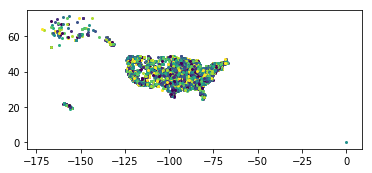

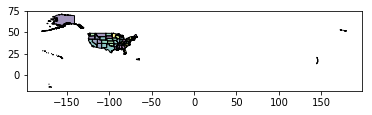

In [41]:
USpowerplant.plot()
USshape.plot()

In [42]:
# USshape[USshape['NAME']=='New York']['geometry'].loc[43]


In [43]:
USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='New York']['geometry'].loc[43])].head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
49,88,Ashokan,New York Power Authority,15296,Electric Utility,Kingston,Ulster,12401,Route 28A,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 4.6 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.949,-74.2063,POINT (-74.2063 41.949)


In [44]:
USpowerplant_NY = USpowerplant.copy()
USpowerplant_NY = USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='New York']['geometry'].loc[43])]
USpowerplant_NY.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
49,88,Ashokan,New York Power Authority,15296,Electric Utility,Kingston,Ulster,12401,Route 28A,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 4.6 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.949,-74.2063,POINT (-74.2063 41.949)


In [45]:
USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='New Jersey']['geometry'].loc[21])].head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
1145,2378,B L England,RC Cape May Holdings LLC,55768,IPP Non-CHP,Beesley's Point,Cape May,8223,900 North Shore Road,coal,...,0.0,NaN,NaN,"Coal = 150 MW, Petroleum = 148 MW",Conventional Steam Coal; Petroleum Liquids;,"EIA-860, EIA-860M and EIA-923",201607,39.2908,-74.6364,POINT (-74.63639999999999 39.2908)


In [46]:
USpowerplant_NJ = USpowerplant.copy()
USpowerplant_NJ = USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='New Jersey']['geometry'].loc[21])]
USpowerplant_NJ.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
1145,2378,B L England,RC Cape May Holdings LLC,55768,IPP Non-CHP,Beesley's Point,Cape May,8223,900 North Shore Road,coal,...,0.0,NaN,NaN,"Coal = 150 MW, Petroleum = 148 MW",Conventional Steam Coal; Petroleum Liquids;,"EIA-860, EIA-860M and EIA-923",201607,39.2908,-74.6364,POINT (-74.63639999999999 39.2908)


In [47]:
USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='Pennsylvania']['geometry'].loc[25])].head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
1424,3096,Brunot Island,NRG Power Midwest LP,14165,IPP Non-CHP,Pittsburg,Allegheny,15204,2849 West Carson Street,natural gas,...,0.0,NaN,NaN,"Natural Gas = 244 MW, Petroleum = 15 MW",Natural Gas Fired Combined Cycle; Petroleum Li...,"EIA-860, EIA-860M and EIA-923",201607,40.464851,-80.043761,POINT (-80.043761 40.464851)


In [48]:
USpowerplant_Pen = USpowerplant.copy()
USpowerplant_Pen = USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='Pennsylvania']['geometry'].loc[25])]
USpowerplant_Pen.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
1424,3096,Brunot Island,NRG Power Midwest LP,14165,IPP Non-CHP,Pittsburg,Allegheny,15204,2849 West Carson Street,natural gas,...,0.0,NaN,NaN,"Natural Gas = 244 MW, Petroleum = 15 MW",Natural Gas Fired Combined Cycle; Petroleum Li...,"EIA-860, EIA-860M and EIA-923",201607,40.464851,-80.043761,POINT (-80.043761 40.464851)


In [49]:
USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='Connecticut']['geometry'].loc[6])].head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
341,539,Rocky River (CT),FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,200 Kent Road,pumped storage,...,0.0,NaN,NaN,Pumped Storage = 29.4 MW,Hydroelectric Pumped Storage,"EIA-860, EIA-860M and EIA-923",201607,41.5826,-73.4349,POINT (-73.4349 41.5826)


In [50]:
USpowerplant_Con = USpowerplant.copy()
USpowerplant_Con = USpowerplant[USpowerplant['geometry'].within(USshape[USshape['NAME']=='Connecticut']['geometry'].loc[6])]
USpowerplant_Con.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
341,539,Rocky River (CT),FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,200 Kent Road,pumped storage,...,0.0,NaN,NaN,Pumped Storage = 29.4 MW,Hydroelectric Pumped Storage,"EIA-860, EIA-860M and EIA-923",201607,41.5826,-73.4349,POINT (-73.4349 41.5826)


(-197.09527795, 197.72483894999999, -18.844392050000003, 75.660855050000009)

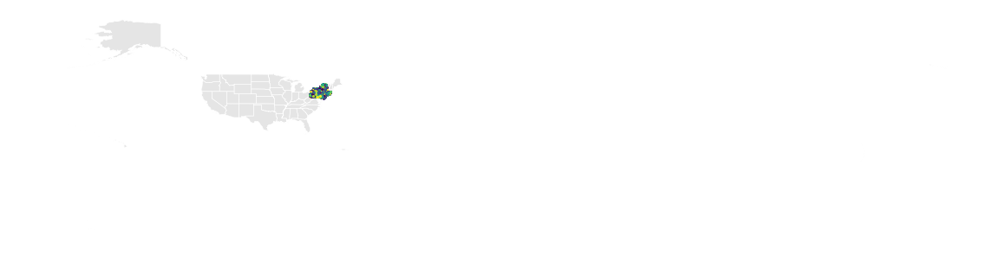

In [51]:
ax = USshape.plot(figsize=(20,20), linewidth=0.5, edgecolor='white',color='#CCCCCC')
USpowerplant_NY.plot(ax=ax)
USpowerplant_NJ.plot(ax=ax)
USpowerplant_Pen.plot(ax=ax)
USpowerplant_Con.plot(ax=ax)
ax.axis('off')


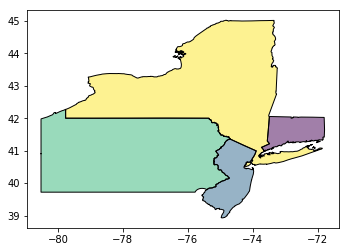

In [52]:
USshape_4State = USshape[USshape['NAME'].str.contains("New York|New Jersey|Pennsylvania|Connecticut", na=False)]
USshape_4State.plot()


(-80.956535849999995, -71.35034915, 38.624152450000004, 45.320216549999998)

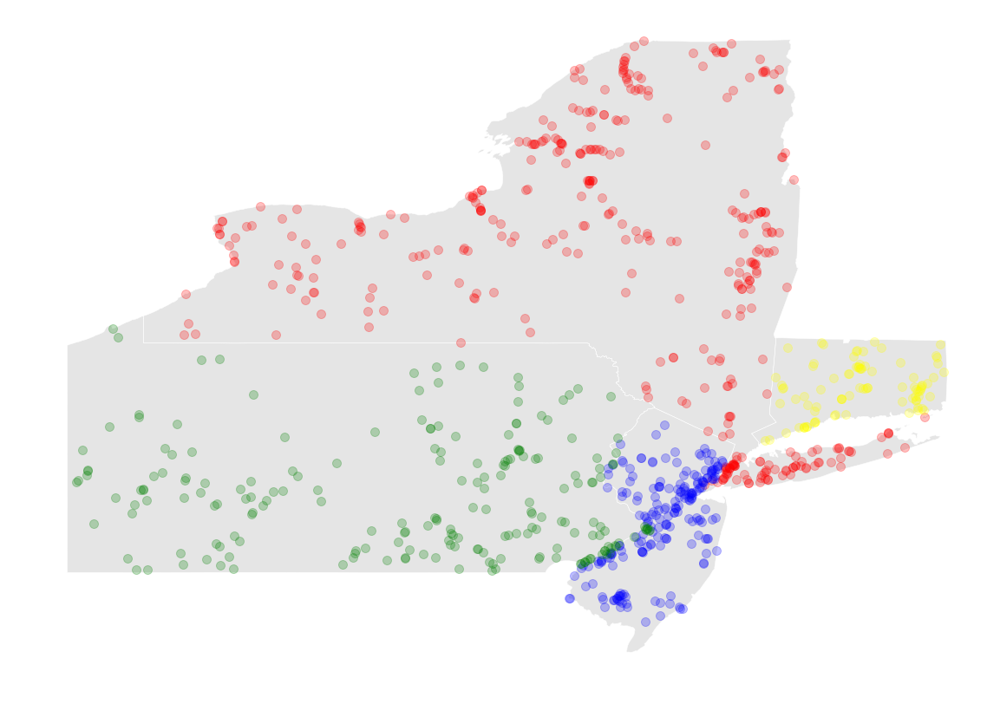

In [53]:
ax = USshape_4State.plot(figsize=(20,20), linewidth=0.5, edgecolor='white',color='#CCCCCC')
USpowerplant_NY.plot(color='red', markersize=10, alpha=0.25 ,ax=ax)
USpowerplant_NJ.plot(color='blue', markersize=10, alpha=0.25, ax=ax)
USpowerplant_Pen.plot(color='green', markersize=10, alpha=0.25, ax=ax)
USpowerplant_Con.plot(color='yellow', markersize=10, alpha=0.25, ax=ax)
ax.axis('off')


## 4. What is the most popular power source by state?

In [54]:
USshape = gpd.read_file("/14-homework-powerplants/cb_2016_us_state_500k/cb_2016_us_state_500k.shp")
USshape.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999..."


In [55]:
USpowerplant = pd.read_csv("/14-homework-powerplants/powerplants.csv")
USpowerplant['geometry'] = USpowerplant.apply(
    lambda row: Point(row.Longitude, row.Latitude), axis=1)
USpowerplant = gpd.GeoDataFrame(USpowerplant)
USpowerplant.crs = {'init':'epsg:4326'}
USpowerplant.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
0,2,Bankhead Dam,Alabama Power Co,195,Electric Utility,Northport,Tuscaloosa,35476,19001 Lock 17 Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 56 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,33.458665,-87.356823,POINT (-87.35682299999999 33.458665)


In [56]:
# USpowerplant.dtypes


In [57]:
USshape_E = USshape.copy()
USshape_E['Coal Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Coal_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4


In [58]:
USshape_E['Bio Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Bio_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9


In [59]:
USshape_E['Hydro Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Hydro_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2


In [60]:
USshape_E['Pumped-Storage Hydro Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['HydroPS_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0


In [61]:
USshape_E['Nuclear Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Nuclear_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum,Nuclear Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0,5066.4


In [62]:
USshape_E['Solar Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Solar_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum,Nuclear Energy Sum,Solar Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0,5066.4,0.0


In [63]:
USshape_E['Wind Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Wind_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum,Nuclear Energy Sum,Solar Energy Sum,Wind Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0,5066.4,0.0,0.0


In [64]:
USshape_E['Geo Energy Sum'] = USshape_E.apply(
    lambda row: USpowerplant[USpowerplant.within(row.geometry)]['Geo_MW'].sum(), axis=1
)
USshape_E.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum,Nuclear Energy Sum,Solar Energy Sum,Wind Energy Sum,Geo Energy Sum
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0,5066.4,0.0,0.0,NaN


In [65]:
import numpy as np


In [66]:
sum_column_names = [
    'Coal Energy Sum', 
    'Bio Energy Sum', 
    'Hydro Energy Sum', 
    'Pumped-Storage Hydro Energy Sum',
    'Nuclear Energy Sum',
    'Solar Energy Sum',
    'Wind Energy Sum',
    'Geo Energy Sum']

USshape_E['most popular power source'] = USshape_E.apply(
    lambda row: max(sum_column_names, key=lambda column_name: row[column_name]), axis=1
)
USshape_E


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry,Coal Energy Sum,Bio Energy Sum,Hydro Energy Sum,Pumped-Storage Hydro Energy Sum,Nuclear Energy Sum,Solar Energy Sum,Wind Energy Sum,Geo Energy Sum,most popular power source
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999...",7979.4,668.9,3232.2,0.0,5066.4,0.0,0.0,NaN,Coal Energy Sum
1,0400000US02,1477946266785,245390495931,02,00,Alaska,02,01785533,AK,"(POLYGON ((-134.737262 58.261354, -134.73441 5...",153.8,7.0,438.1,0.0,0.0,0.0,60.6,NaN,Hydro Energy Sum
2,0400000US04,294198560125,1027346486,04,00,Arizona,04,01779777,AZ,"POLYGON ((-114.816294 32.508038, -114.814321 3...",5910.0,30.7,1681.2,216.3,3937.0,1568.5,267.3,NaN,Coal Energy Sum
3,0400000US05,134771517596,2960191698,05,00,Arkansas,05,00068085,AR,"POLYGON ((-94.6178329666013 36.4994141203285, ...",5122.4,312.4,1266.2,28.0,1808.5,12.0,0.0,NaN,Coal Energy Sum
4,0400000US06,403501101370,20466718403,06,00,California,06,01779778,CA,"(POLYGON ((-118.604415 33.478552, -118.598783 ...",90.0,1352.0,10186.2,3869.3,2240.0,8146.9,5720.9,1934.2,Hydro Energy Sum
5,0400000US08,268429343790,1175112870,08,00,Colorado,08,01779779,CO,"POLYGON ((-109.060253 38.599328, -109.059541 3...",5089.8,27.4,677.7,562.5,0.0,206.2,2961.8,NaN,Coal Energy Sum
6,0400000US09,12542638347,1815476291,09,00,Connecticut,09,01779780,CT,"(POLYGON ((-72.761427 41.242333, -72.759733 41...",383.4,199.2,122.2,29.4,2087.8,13.2,0.0,NaN,Nuclear Energy Sum
7,0400000US10,5047194742,1398720828,10,00,Delaware,10,01779781,DE,"(POLYGON ((-75.565546 39.51485, -75.5617429999...",410.0,12.2,0.0,0.0,0.0,30.7,2.0,NaN,Coal Energy Sum
8,0400000US11,158364992,18633403,11,00,District of Columbia,11,01702382,DC,"POLYGON ((-77.119759 38.934343, -77.1125318000...",0.0,12.0,0.0,0.0,0.0,0.0,0.0,NaN,Bio Energy Sum
9,0400000US13,149169848456,4741100880,13,00,Georgia,13,01705317,GA,"(POLYGON ((-81.27939099999999 31.30792, -81.27...",9508.5,897.8,2086.3,1862.2,4061.0,471.3,0.0,NaN,Coal Energy Sum


## 5. Get the average (or highest/worst) PM2.5 within XXX miles of each power plant (you pick the distance). Is coal dirtier than other kinds of plants?

Finding the air quality within 5 miles of each power plant

In [67]:
USshape = gpd.read_file("/14-homework-powerplants/cb_2016_us_state_500k/cb_2016_us_state_500k.shp")
USshape.head(1)


,AFFGEOID,ALAND,AWATER,GEOID,LSAD,NAME,STATEFP,STATENS,STUSPS,geometry
0,0400000US01,131173688951,4593686489,01,00,Alabama,01,01779775,AL,"(POLYGON ((-88.053375 30.506987, -88.051087999..."


In [68]:
USpowerplant = pd.read_csv("14-homework-powerplants/powerplants.csv")
USpowerplant['geometry'] = USpowerplant.apply(
    lambda row: Point(row.Longitude, row.Latitude), axis=1)
USpowerplant = gpd.GeoDataFrame(USpowerplant)
USpowerplant.crs = {'proj':'merc'}
USpowerplant.head(1)


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
0,2,Bankhead Dam,Alabama Power Co,195,Electric Utility,Northport,Tuscaloosa,35476,19001 Lock 17 Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 56 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,33.458665,-87.356823,POINT (-87.35682299999999 33.458665)


In [69]:
USair = pd.read_csv("/14-homework-powerplants/pm25_annual_fixed.csv")
USair['geometry'] = USair.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)
USair = gpd.GeoDataFrame(USair)
USair.crs = {'proj':'merc'}
USair.head(1)


,State Code,County Code,Site Num,Parameter Code,POC,Latitude,Longitude,Datum,Parameter Name,Sample Duration,...,50th Percentile,10th Percentile,Local Site Name,Address,State Name,County Name,City Name,CBSA Name,Date of Last Change,geometry
0,1,3,10,88101,1,30.497478,-87.880258,NAD83,PM2.5 - Local Conditions,24 HOUR,...,5.7,3.8,"FAIRHOPE, Alabama","FAIRHOPE HIGH SCHOOL, 1 PIRATE DRIVE, FAIRHOPE...",Alabama,Baldwin,Fairhope,"Daphne-Fairhope-Foley, AL",2017-05-18,POINT (-87.880258 30.497478)


In [70]:
USpowerplant.dtypes


Plant_Code      int64
Plant_Name     object
Utility_Na     object
Utility_ID      int64
sector_nam     object
City           object
County         object
Zip             int64
Street_Add     object
PrimSource     object
Total_MW      float64
Coal_MW       float64
NG_MW         float64
Crude_MW      float64
Bio_MW        float64
Hydro_MW      float64
HydroPS_MW    float64
Nuclear_MW    float64
Solar_MW      float64
Wind_MW       float64
Geo_MW        float64
Other_MW      float64
source_des     object
tech_desc      object
Source         object
Period          int64
Latitude      float64
Longitude     float64
geometry       object
dtype: object

In [71]:
print(USpowerplant.crs)
print(USair.crs)


{'proj': 'merc'}
{'proj': 'merc'}


### Coal Power Plant

In [72]:
USpowerplant_coal = USpowerplant[~USpowerplant['Coal_MW'].isnull()]
USpowerplant_coal = USpowerplant_coal[ USpowerplant_coal['Coal_MW'] != 0.0]
USpowerplant_coal.shape


(408, 29)

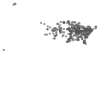

In [73]:
# 0.0905051 degree of Longitude = 5 miles
buffered_USpowerplant_coal = USpowerplant_coal.buffer(0.0905051)
buffered_USpowerplant_coal.unary_union


In [74]:
USair_coal_near = USair[USair.intersects(buffered_USpowerplant_coal.unary_union)]
print(USair_coal_near['Arithmetic Mean'].mean() )


8.37922350794


### Natural Gas Power Plant

In [75]:
USpowerplant_NG = USpowerplant[~USpowerplant['NG_MW'].isnull()]
USpowerplant_NG = USpowerplant_NG[ USpowerplant_NG['NG_MW'] != 0.0]


In [76]:
buffered_USpowerplant_NG = USpowerplant_NG.buffer(0.0905051)
buffered_USpowerplant_NG.unary_union


In [77]:
USair_NG_near = USair[USair.intersects(buffered_USpowerplant_NG.unary_union)]
print(USair_NG_near['Arithmetic Mean'].mean() )


8.48361224


### Crude Oil Power Plant

In [78]:
USpowerplant_Crude = USpowerplant[~USpowerplant['Crude_MW'].isnull()]
USpowerplant_Crude = USpowerplant_Crude[ USpowerplant_Crude['Crude_MW'] != 0.0]
USpowerplant_Crude.shape


(1078, 29)

In [79]:
buffered_USpowerplant_Crude = USpowerplant_Crude.buffer(0.0905051)
buffered_USpowerplant_Crude.unary_union


In [80]:
USair_Crude_near = USair[USair.intersects(buffered_USpowerplant_Crude.unary_union)]
print(USair_Crude_near['Arithmetic Mean'].mean() )


8.65378105714


### Bio Power Plant

In [81]:
USpowerplant_Bio = USpowerplant[~USpowerplant['Bio_MW'].isnull()]
USpowerplant_Bio = USpowerplant_Bio[ USpowerplant_Bio['Bio_MW'] != 0.0]


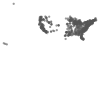

In [82]:
buffered_USpowerplant_Bio = USpowerplant_Bio.buffer(0.0905051)
buffered_USpowerplant_Bio.unary_union


In [83]:
USair_Bio_near = USair[USair.intersects(buffered_USpowerplant_Bio.unary_union)]
print(USair_Bio_near['Arithmetic Mean'].mean() )


8.38982141837


### Hydro Power Plant

In [84]:
USpowerplant_Hydro = USpowerplant[~USpowerplant['Hydro_MW'].isnull()]
USpowerplant_Hydro = USpowerplant_Hydro[ USpowerplant_Hydro['Hydro_MW'] != 0.0]


In [85]:
buffered_USpowerplant_Hydro = USpowerplant_Hydro.buffer(0.0905051)
buffered_USpowerplant_Hydro.unary_union


In [86]:
USair_Hydro_near = USair[USair.intersects(buffered_USpowerplant_Hydro.unary_union)]
print(USair_Hydro_near['Arithmetic Mean'].mean() )


7.93754726531


### Pumped-Storage Hydro Power Plant

In [87]:
USpowerplant_HydroPS = USpowerplant[~USpowerplant['Hydro_MW'].isnull()]
USpowerplant_HydroPS = USpowerplant_HydroPS[ USpowerplant_HydroPS['Hydro_MW'] != 0.0]


In [88]:
buffered_USpowerplant_HydroPS = USpowerplant_HydroPS.buffer(0.0905051)
buffered_USpowerplant_HydroPS.unary_union


In [89]:
USair_HydroPS_near = USair[USair.intersects(buffered_USpowerplant_HydroPS.unary_union)]
print(USair_HydroPS_near['Arithmetic Mean'].mean() )


7.93754726531


### Nuclear Power Plant

In [90]:
USpowerplant_Nuclear = USpowerplant[~USpowerplant['Nuclear_MW'].isnull()]
USpowerplant_Nuclear = USpowerplant_Nuclear[ USpowerplant_Nuclear['Nuclear_MW'] != 0.0]


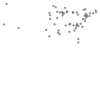

In [91]:
buffered_USpowerplant_Nuclear = USpowerplant_Nuclear.buffer(0.0905051)
buffered_USpowerplant_Nuclear.unary_union


In [92]:
USair_Nuclear_near = USair[USair.intersects(buffered_USpowerplant_Nuclear.unary_union)]
print(USair_Nuclear_near['Arithmetic Mean'].mean() )


6.753333


### Solar Power Plant

In [93]:
USpowerplant_Solar = USpowerplant[~USpowerplant['Solar_MW'].isnull()]
USpowerplant_Solar = USpowerplant_Solar[ USpowerplant_Solar['Solar_MW'] != 0.0]


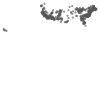

In [94]:
buffered_USpowerplant_Solar = USpowerplant_Solar.buffer(0.0905051)
buffered_USpowerplant_Solar.unary_union


In [95]:
USair_Solar_near = USair[USair.intersects(buffered_USpowerplant_Solar.unary_union)]
print(USair_Solar_near['Arithmetic Mean'].mean() )


8.90067889706


### Wind Power Plant

In [96]:
USpowerplant_Wind = USpowerplant[~USpowerplant['Wind_MW'].isnull()]
USpowerplant_Wind = USpowerplant_Wind[ USpowerplant_Wind['Wind_MW'] != 0.0]


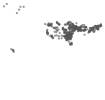

In [97]:
buffered_USpowerplant_Wind = USpowerplant_Wind.buffer(0.0905051)
buffered_USpowerplant_Wind.unary_union


In [98]:
USair_Wind_near = USair[USair.intersects(buffered_USpowerplant_Wind.unary_union)]
print(USair_Wind_near['Arithmetic Mean'].mean() )


6.5787417


### Geo Power Plant

In [99]:
USpowerplant_Geo = USpowerplant[~USpowerplant['Geo_MW'].isnull()]
USpowerplant_Geo = USpowerplant_Geo[ USpowerplant_Geo['Geo_MW'] != 0.0]


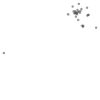

In [100]:
buffered_USpowerplant_Geo = USpowerplant_Geo.buffer(0.0905051)
buffered_USpowerplant_Geo.unary_union


In [101]:
USair_Geo_near = USair[USair.intersects(buffered_USpowerplant_Geo.unary_union)]
print(USair_Geo_near['Arithmetic Mean'].mean() )


7.391746


### Comparison

In [119]:
print("The average air quality near                 coal power plants is", USair_coal_near['Arithmetic Mean'].mean()  )
print("The average air quality near          natural gas power plants is", USair_NG_near['Arithmetic Mean'].mean()  )
print("The average air quality near            crude oil power plants is", USair_Crude_near['Arithmetic Mean'].mean()  )
print("The average air quality near                  bio power plants is", USair_Bio_near['Arithmetic Mean'].mean()  )
print("The average air quality near                hydro power plants is", USair_Hydro_near['Arithmetic Mean'].mean()  )
print("The average air quality near pumped-storage hydro power plants is", USair_HydroPS_near['Arithmetic Mean'].mean()  )
print("The average air quality near              nuclear power plants is", USair_Nuclear_near['Arithmetic Mean'].mean()  )
print("The average air quality near                solar power plants is", USair_Solar_near['Arithmetic Mean'].mean()  )
print("The average air quality near                 wind power plants is", USair_Wind_near['Arithmetic Mean'].mean()  )
print("The average air quality near                  geo power plants is", USair_Geo_near['Arithmetic Mean'].mean()  )


The average air quality near                 coal power plants is 8.37922350794
The average air quality near          natural gas power plants is 8.48361224
The average air quality near            crude oil power plants is 8.65378105714
The average air quality near                  bio power plants is 8.38982141837
The average air quality near                hydro power plants is 7.93754726531
The average air quality near pumped-storage hydro power plants is 7.93754726531
The average air quality near              nuclear power plants is 6.753333
The average air quality near                solar power plants is 8.90067889706
The average air quality near                 wind power plants is 6.5787417
The average air quality near                  geo power plants is 7.391746


Is coal dirtier than other kinds of plants?

The type of power plant with the dirtiest air around is the solar power plant. (Why?)


## 6. Make a map of the power plants within 150 miles of New York City. I want it centered on New York City, zoomed in a good amount.

In [103]:
USpowerplant.crs = {'proj': 'merc'}
print(USpowerplant.crs)
print(city_NY.crs)


{'proj': 'merc'}
{'proj': 'merc'}


In [104]:
# 1        degree of Longitude = 55.2428 miles
# 2.715284 degrees of Longitude = 150 miles
buffered_city_NY = city_NY.buffer(2.715284)
buffered_city_NY.head(1)


0    POLYGON ((-71.29065730000001 40.7127837, -71.3...
dtype: object

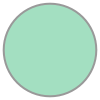

In [105]:
buffered_city_NY.unary_union


In [106]:
USpowerplant_150_NY = USpowerplant[USpowerplant.within(buffered_city_NY.unary_union)]
USpowerplant_150_NY


,Plant_Code,Plant_Name,Utility_Na,Utility_ID,sector_nam,City,County,Zip,Street_Add,PrimSource,...,Wind_MW,Geo_MW,Other_MW,source_des,tech_desc,Source,Period,Latitude,Longitude,geometry
49,88,Ashokan,New York Power Authority,15296,Electric Utility,Kingston,Ulster,12401,Route 28A,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 4.6 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.949000,-74.206300,POINT (-74.2063 41.949)
341,539,Rocky River (CT),FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,200 Kent Road,pumped storage,...,0.0,NaN,NaN,Pumped Storage = 29.4 MW,Hydroelectric Pumped Storage,"EIA-860, EIA-860M and EIA-923",201607,41.582600,-73.434900,POINT (-73.4349 41.5826)
342,540,Branford,Connecticut Jet Power LLC,22379,IPP Non-CHP,Branford,New Haven,6450,Route 1,petroleum,...,0.0,NaN,NaN,Petroleum = 17.4 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.292500,-72.794200,POINT (-72.7942 41.2925)
343,541,Bulls Bridge,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,New Milford,Litchfield,6776,781 Kent Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 8.4 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.659046,-73.491984,POINT (-73.491984 41.659046)
344,542,Cos Cob,Connecticut Jet Power LLC,22379,IPP Non-CHP,Greenwich,Fairfield,6430,Sound Shore Drive,petroleum,...,0.0,NaN,NaN,Petroleum = 95.6 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.028900,-73.598900,POINT (-73.5989 41.0289)
345,544,Devon Station,Devon Power LLC,22350,IPP Non-CHP,Milford,New Haven,6460,734 Naugatuck Avenue,petroleum,...,0.0,NaN,NaN,Petroleum = 132.5 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.209797,-73.108976,POINT (-73.108976 41.20979699999999)
346,546,Montville Station,NRG Montville Operations Inc,22380,IPP Non-CHP,Uncasvlle,New London,6382,74 Lathrop Road,petroleum,...,0.0,NaN,NaN,Petroleum = 496.4 MW,Petroleum Liquids,"EIA-860, EIA-860M and EIA-923",201607,41.428100,-72.101900,POINT (-72.1019 41.4281)
347,547,Northfield Mountain,"FirstLight Power Resources, Inc. - MA",58185,IPP Non-CHP,Northfield,Franklin,1360,99 Millers Falls Road,pumped storage,...,0.0,NaN,NaN,Pumped Storage = 1168 MW,Hydroelectric Pumped Storage,"EIA-860, EIA-860M and EIA-923",201607,42.610683,-72.471643,POINT (-72.471643 42.610683)
349,551,Scotland Dam,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,Windham,Windham,6280,695 Jerusalem Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 1.7 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.665100,-72.122100,POINT (-72.1221 41.6651)
350,552,Shepaug,FirstLight Power Resources Services LLC,54895,IPP Non-CHP,Southbury,New Haven,6488,2225 River Road,hydroelectric,...,0.0,NaN,NaN,Hydroelectric = 41.5 MW,Conventional Hydroelectric,"EIA-860, EIA-860M and EIA-923",201607,41.448420,-73.295321,POINT (-73.295321 41.44842)


In [107]:
USshape_NY = USshape.copy()
USshape_NY.crs = {'proj': 'merc'}
USshape_NY.crs


{'proj': 'merc'}

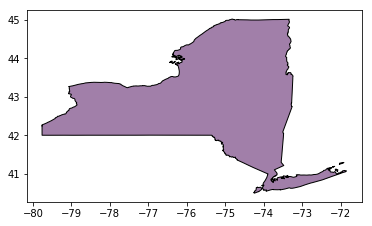

In [108]:
USshape_NY = USshape[USshape['NAME'].str.contains("New York", na=False)]
USshape_NY.plot()


(-80.176398500000005, -71.062975499999993, 37.9933744, 45.350253600000002)

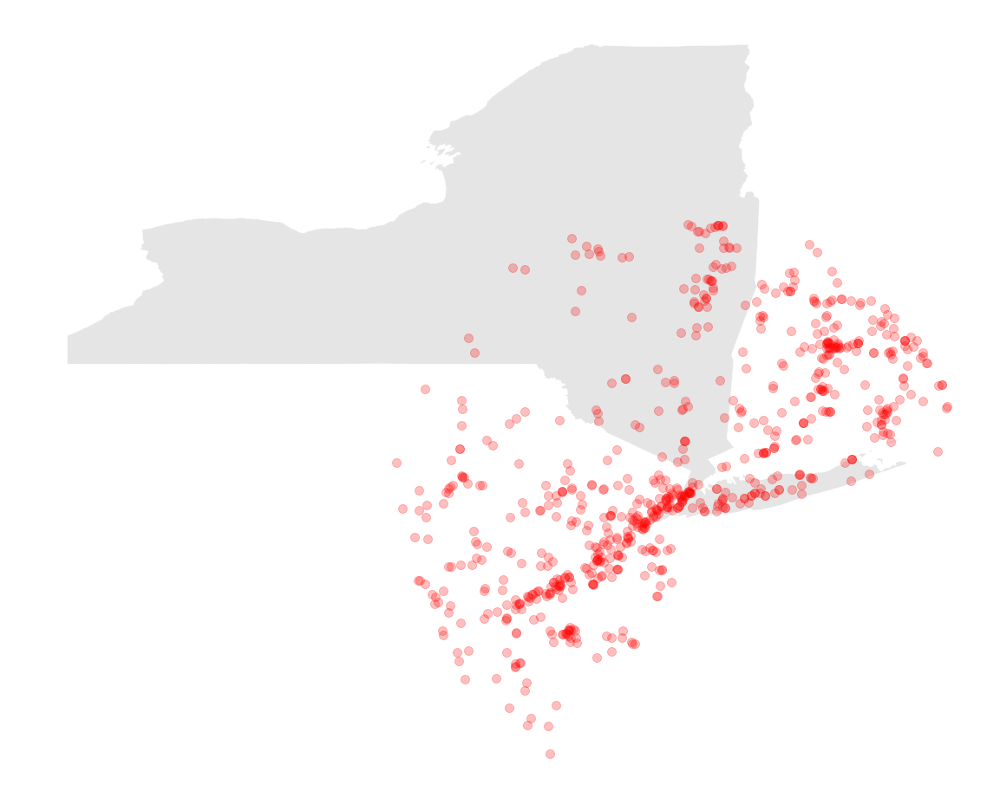

In [109]:
ax = USshape_NY.plot(figsize=(20,20), linewidth=0.5, edgecolor='white',color='#CCCCCC')
USpowerplant_150_NY.plot(color='red', markersize=10, alpha=0.25 ,ax=ax)
ax.axis('off')


## 7. Are places with below-average air quality closer to power plants?

Found if there are power plants within 5 miles distance

In [110]:
USair = pd.read_csv("/14-homework-powerplants/pm25_annual_fixed.csv")
USair['geometry'] = USair.apply(lambda row: Point(row.Longitude, row.Latitude), axis=1)
USair = gpd.GeoDataFrame(USair)
USair.crs = {'proj':'merc'}
USair.head(1)


,State Code,County Code,Site Num,Parameter Code,POC,Latitude,Longitude,Datum,Parameter Name,Sample Duration,...,50th Percentile,10th Percentile,Local Site Name,Address,State Name,County Name,City Name,CBSA Name,Date of Last Change,geometry
0,1,3,10,88101,1,30.497478,-87.880258,NAD83,PM2.5 - Local Conditions,24 HOUR,...,5.7,3.8,"FAIRHOPE, Alabama","FAIRHOPE HIGH SCHOOL, 1 PIRATE DRIVE, FAIRHOPE...",Alabama,Baldwin,Fairhope,"Daphne-Fairhope-Foley, AL",2017-05-18,POINT (-87.880258 30.497478)


In [111]:
# USair.dtypes


State Code                         int64
County Code                        int64
Site Num                           int64
Parameter Code                     int64
POC                                int64
Latitude                         float64
Longitude                        float64
Datum                             object
Parameter Name                    object
Sample Duration                   object
Pollutant Standard                object
Metric Used                       object
Method Name                       object
Year                               int64
Units of Measure                  object
Event Type                        object
Observation Count                  int64
Observation Percent                int64
Completeness Indicator            object
Valid Day Count                    int64
Required Day Count                 int64
Exceptional Data Count             int64
Null Data Count                    int64
Primary Exceedance Count         float64
Secondary Exceed

In [112]:
USair_below = USair[USair['Arithmetic Mean'] < USair['Arithmetic Mean'].mean()]
USair_above = USair[USair['Arithmetic Mean'] >= USair['Arithmetic Mean'].mean()]
print(USair_below.shape[0])
print(USair_above.shape[0])


222
219


In [113]:
print(USpowerplant.crs)
print(USair.crs)


{'proj': 'merc'}
{'proj': 'merc'}


In [114]:
buffered_USair_below = USpowerplant.buffer(0.1810102)
buffered_USair_below.unary_union


In [115]:
buffered_USair_above = USpowerplant.buffer(0.1810102)
buffered_USair_above.unary_union


In [116]:
USpowerplant_near_below = USpowerplant[USpowerplant.intersects(buffered_USair_below.unary_union)]
USpowerplant_near_below.shape[0]


7610

In [117]:
USpowerplant_near_above = USpowerplant[USpowerplant.intersects(buffered_USair_above.unary_union)]
USpowerplant_near_above.shape[0]


7610

In [120]:
print("There are an average of", USpowerplant_near_below.shape[0]/USair_below.shape[0], "power plants near points where the air quality is below average.")
print("There are an average of", USpowerplant_near_above.shape[0]/USair_above.shape[0], "power plants near points where the air quality is the same as or above average.")


There are an average of 34.27927927927928 power plants near points where the air quality is below average.
There are an average of 34.74885844748859 power plants near points where the air quality is the same as or above average.


The places with above or same average air quality is closer to power plants
